In [1]:
using CSV, DataFrames, Plots

In [2]:
demanda = CSV.read("demanda.csv", DataFrame, header=2, limit=476)
zip_codes = CSV.read("zip.csv", DataFrame)
demanda = demanda[!,[1,22,23]]
rename!(demanda,[:ZIP, :TotalGallons, :TotalStations])
conversion_factor = 3.78541*12 # liters/gallon * kms/liter
demanda[!,:TotalKms] = demanda[!,:TotalGallons] * conversion_factor
data = innerjoin(demanda,zip_codes, on=:ZIP)

Row,ZIP,TotalGallons,TotalStations,TotalKms,LAT,LNG
,Int64,Int64,Int64,Float64,Float64,Float64
1,90001,12471266,7,5.66506e8,33.974,-118.25
2,90003,22195762,12,1.00824e9,33.9641,-118.273
3,90004,12093863,9,5.49363e8,34.0762,-118.311
4,90007,18818231,8,8.54817e8,34.0281,-118.285
5,90016,20203517,13,9.17743e8,34.0283,-118.354
6,90019,21177617,7,9.61992e8,34.0498,-118.338
7,90022,21944459,9,9.96825e8,34.0237,-118.156
8,90023,16678269,9,7.57609e8,34.0225,-118.2
9,90025,18492834,12,8.40036e8,34.0454,-118.446


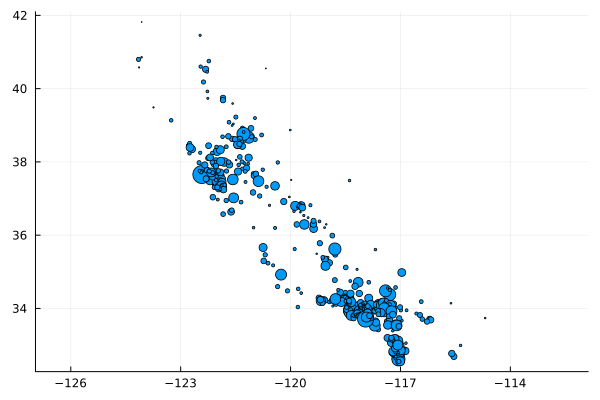

In [3]:
scatter(data[!,:LNG], data[!,:LAT], 
        markersize=data[!,:TotalKms]/maximum(data[!,:TotalKms])*10, 
        aspectratio=:equal,
        legend=:none)

In [4]:
ZIP_CODES_DOWNTOWN_LA = [90601, 90602, 90603, 90605, 90631, 91006, 91007, 91008, 91010, 91016, 91024, 91030, 91108, 91702, 91706, 91722, 91723, 91724, 91731, 91732, 91733, 91741, 91744, 91745, 91746, 91748, 91754, 91756, 91765, 91770, 91773, 91775, 91776, 91780, 91789, 91790, 91791, 91792, 91801, 91803, 92821, 92823,
91711, 91750, 91766, 91767, 91768, 91773,
90004, 90005, 90006, 90012, 90013, 90014, 90015, 90017, 90019, 90021, 90026, 90027, 90028, 90035, 90036, 90038, 90039, 90046, 90048, 90057, 90068, 90069, 90071,
90022, 90023, 90031, 90032, 90033, 90063,
90024, 90025, 90034, 90035, 90049, 90056, 90064, 90066, 90067, 90073, 90077, 90094, 90210, 90212, 90230, 90232, 90272, 90291, 90292, 90401, 90402, 90403, 90404, 90405,
90001, 90002, 90003, 90007, 90008, 90011, 90016, 90018, 90037, 90043, 90044, 90047, 90059, 90061, 90062, 90089, 90220, 90305,
90040, 90058, 90201, 90220, 90221, 90240, 90241, 90242, 90255, 90262, 90270, 90280, 90604, 90605, 90606, 90638, 90640, 90650, 90660, 90670, 90703, 90706, 90723,
90265, 90290, 91301, 91302, 91361, 91362,
90045, 90245, 90249, 90250, 90254, 90260, 90261, 90266, 90274, 90275, 90277, 90278, 90293, 90301, 90302, 90303, 90304, 90501, 90503, 90504, 90505, 90506, 90717,
90220, 90221, 90502, 90710, 90712, 90713, 90715, 90716, 90731, 90732, 90744, 90745, 90746, 90755, 90802, 90803, 90804, 90805, 90806, 90807, 90808, 90810, 90813, 90814, 90815, 90822, 90831, 90840, 90846]

data2 = filter(:ZIP => x-> x ∈ ZIP_CODES_DOWNTOWN_LA, data)

Row,ZIP,TotalGallons,TotalStations,TotalKms,LAT,LNG
,Int64,Int64,Int64,Float64,Float64,Float64
1,90001,12471266,7,5.66506e8,33.974,-118.25
2,90003,22195762,12,1.00824e9,33.9641,-118.273
3,90004,12093863,9,5.49363e8,34.0762,-118.311
4,90007,18818231,8,8.54817e8,34.0281,-118.285
5,90016,20203517,13,9.17743e8,34.0283,-118.354
6,90019,21177617,7,9.61992e8,34.0498,-118.338
7,90022,21944459,9,9.96825e8,34.0237,-118.156
8,90023,16678269,9,7.57609e8,34.0225,-118.2
9,90025,18492834,12,8.40036e8,34.0454,-118.446


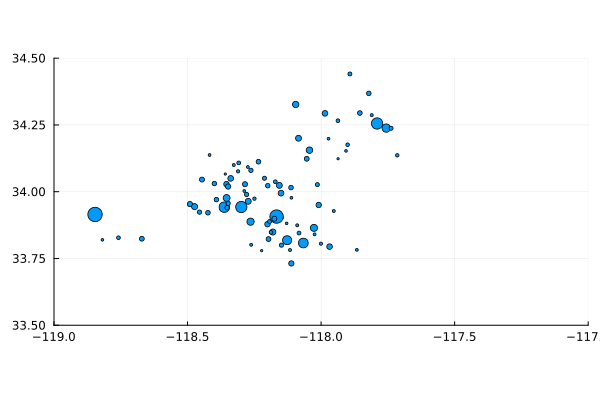

In [5]:
scatter(data2[!,:LNG], data[!,:LAT], 
        markersize=data[!,:TotalKms]/maximum(data[!,:TotalKms])*10, 
        aspectratio=:equal,
        legend=:none,
        xlims = (-119,-117),
        ylims = (33.5,34.5)
        )

In [6]:
using Shapefile
table = Shapefile.Table("County_Boundaries/County_Boundaries.shp")

Shapefile.Table{Union{Missing, Shapefile.Polygon}} with 11 rows and the following 6 columns:
	
geometry, OBJECTID, TYPE, NAME, ShapeSTAre, ShapeSTLen


In [7]:
geoms = Shapefile.shapes(table)

11-element Vector{Union{Missing, Shapefile.Polygon}}:
 Polygon(1332 Points)
 Polygon(2806 Points)
 Polygon(686 Points)
 Polygon(1410 Points)
 Polygon(4894 Points)
 Polygon(10504 Points)
 Polygon(23574 Points)
 Polygon(8547 Points)
 Polygon(18053 Points)
 Polygon(49267 Points)
 Polygon(9587 Points)

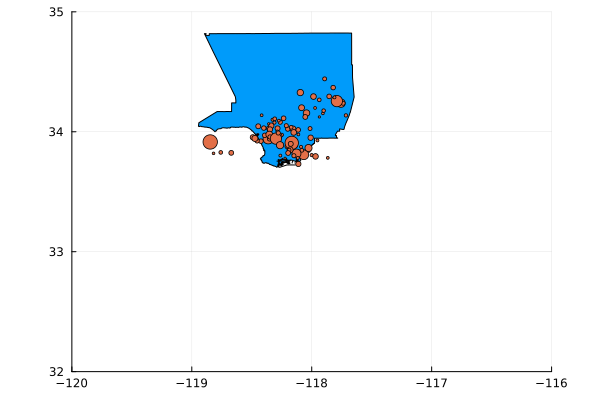

In [8]:
la_county = geoms[9]
plot(la_county)
scatter!(data2[!,:LNG], data[!,:LAT], 
        markersize=data[!,:TotalKms]/maximum(data[!,:TotalKms])*10, 
        aspectratio=:equal,
        legend=:none,
        xlims = (-120,-116),
        ylims = (32,35)
        )

In [9]:
z = [p.x + im*p.y for p in la_county.points]
z=[z[1];z[15210:-10:1]]
#z=[z[1];z[end:-1:1]]

1522-element Vector{ComplexF64}:
  -117.7387248021367 + 34.82325153751738im
 -117.86358970757944 + 34.822664302013585im
 -117.90012133426183 + 34.82254124997341im
 -117.93443899916525 + 34.82257660069107im
  -117.9665879388269 + 34.82261571621761im
 -117.97910052463419 + 34.822622858920404im
 -118.00115507817246 + 34.82243356907404im
 -118.02353340990318 + 34.82216235661254im
 -118.04191135913409 + 34.8219516372133im
 -118.07791719510506 + 34.82152828148057im
 -118.11106862393704 + 34.82114951618681im
 -118.14003792398788 + 34.82085133828377im
 -118.15607472864261 + 34.820687649954934im
                     ⋮
 -117.66706513595213 + 34.67882343860102im
 -117.66710813724907 + 34.69110022603958im
 -117.66714846762652 + 34.703253991169746im
 -117.66722231657508 + 34.724637996368415im
  -117.6672343382381 + 34.73795774746762im
 -117.66721035099916 + 34.76382354287821im
  -117.6672864319228 + 34.783871686904156im
 -117.66732995049693 + 34.79344061451718im
 -117.66968147764712 + 34.8225265119

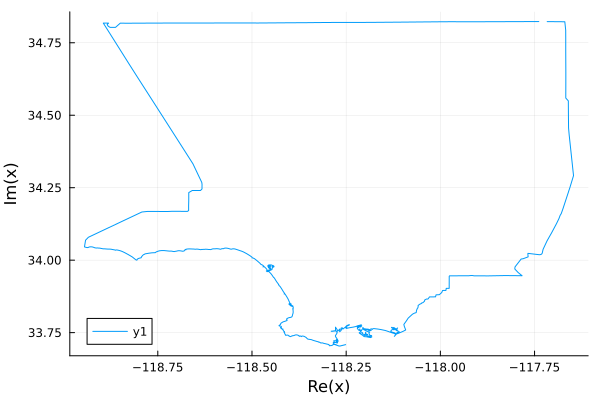

In [10]:
plot(z)

In [11]:
function is_inside(x,y)

    z0 = x+im*y
    
    index = real(sum(1.0./(z[1:end-1].-z0).*diff(z))/(2*pi*im))
    println(index)
    return isapprox(index,1,atol=1e-2)
    
end

is_inside(-118.25,34.25)



0.9897088383823669


false

In [12]:
lax = filter(row -> is_inside(row[:LNG],row[:LAT]) ,data)

0.9963064231556504
0.9965794958758293
0.9928673146042999
0.9948003985696405
0.9936996602449966
0.9932140545670904
0.9965065574073725
0.9958525043074486
0.9923043828289062
0.9937256290064053
0.9917402611264549
0.9953203815472192
0.9908915808737736
0.9955524979542557
0.9963957382887473
0.9938350329081297
1.0032573571445589
0.9907810991263712
0.9971524772863025
0.99763074173579
0.9974722676207338
0.989705138511582
0.9938551831698361
0.9961797153114699
0.9984550847761058
0.9919013419640601
0.9953442343699876
0.9981004811440711
0.9989206951712364
0.9982232412927685
0.9967886961580077
1.0110209670389625
0.9964187133864466
0.6551792089359115
0.9986816503440347
0.997611682859297
0.9935093474888208
0.9989686404400262
0.983146316684964
0.9883985689521276
0.9964025353875119
0.0068892411776204565
-0.01069033603226465
-0.003752671364955388
-0.009573389089585936
0.9688134086980253
0.9974070891413419
0.9940889146488477
0.9969835220952342
-0.005027711317006181
0.992960695143863
0.9941808623347411
0.99

Row,ZIP,TotalGallons,TotalStations,TotalKms,LAT,LNG
,Int64,Int64,Int64,Float64,Float64,Float64
1,90001,12471266,7,5.66506e8,33.974,-118.25
2,90003,22195762,12,1.00824e9,33.9641,-118.273
3,90004,12093863,9,5.49363e8,34.0762,-118.311
4,90007,18818231,8,8.54817e8,34.0281,-118.285
5,90016,20203517,13,9.17743e8,34.0283,-118.354
6,90019,21177617,7,9.61992e8,34.0498,-118.338
7,90022,21944459,9,9.96825e8,34.0237,-118.156
8,90023,16678269,9,7.57609e8,34.0225,-118.2
9,90025,18492834,12,8.40036e8,34.0454,-118.446


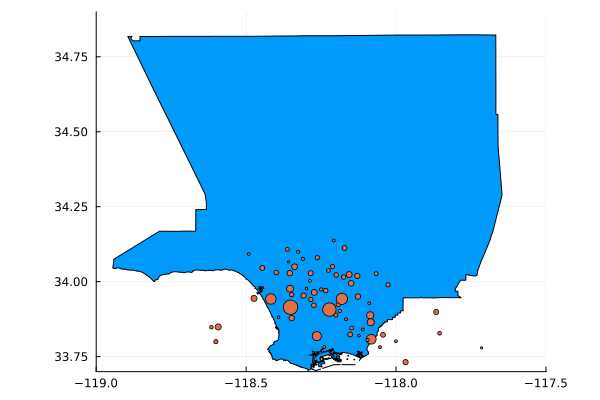

In [13]:
plot(la_county)
scatter!(lax[!,:LNG], data[!,:LAT], 
        markersize=data[!,:TotalKms]/maximum(data[!,:TotalKms])*10, 
        aspectratio=:equal,
        legend=:none,
        xlims = (-119,-117.5),
        ylims = (33.7,34.9)
        )

In [14]:
is_inside.(lax[!,:LNG], lax[!,:LAT])

0.9963064231556504
0.9965794958758293
0.9928673146042999
0.9948003985696405
0.9936996602449966
0.9932140545670904
0.9965065574073725
0.9958525043074486
0.9923043828289062
0.9937256290064053
0.9917402611264549
0.9953203815472192
0.9908915808737736
0.9955524979542557
0.9963957382887473
0.9938350329081297
1.0032573571445589
0.9907810991263712
0.9971524772863025
0.99763074173579
0.9974722676207338
0.9938551831698361
0.9961797153114699
0.9984550847761058
0.9919013419640601
0.9953442343699876
0.9981004811440711
0.9989206951712364
0.9982232412927685
0.9967886961580077
0.9964187133864466
0.9986816503440347
0.997611682859297
0.9935093474888208
0.9989686404400262
0.9964025353875119
0.9974070891413419
0.9940889146488477
0.9969835220952342
0.992960695143863
0.9941808623347411
0.9957109262476828
0.9960038328751302
1.0011204193826315
0.9980090425871678
1.0089995999009023
1.001771601596232
1.0017981717379296
1.0017836364940718
1.0025589572956823
0.9980463788039793
0.990950163694772
0.998038032874797


65-element BitVector:
 1
 1
 1
 1
 1
 1
 1
 1
 1
 1
 1
 1
 1
 ⋮
 1
 1
 1
 1
 1
 1
 1
 1
 1
 1
 1
 1

In [15]:
is_inside(-118.015,33.8452)

0.007035203831246697


false

In [16]:
lax[1,:]

Row,ZIP,TotalGallons,TotalStations,TotalKms,LAT,LNG
,Int64,Int64,Int64,Float64,Float64,Float64
1,90001,12471266,7,5.66506e8,33.974,-118.25


In [17]:
z[1]

-117.7387248021367 + 34.82325153751738im

In [18]:
z[2]

-117.86358970757944 + 34.822664302013585im

In [19]:
z[3]

-117.90012133426183 + 34.82254124997341im

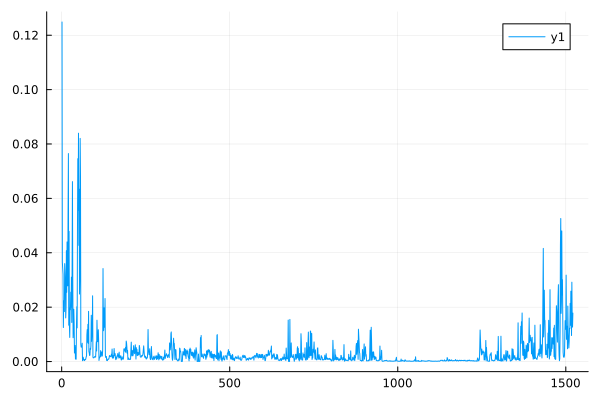

In [20]:
plot(abs.(diff(z)))

In [21]:
table = Shapefile.Table("zip_code_boundaries/CAMS_ZIPCODE_PARCEL_SPECIFIC.shp")
geom = Shapefile.shapes(table)

311-element Vector{Union{Missing, Shapefile.Polygon}}:
 Polygon(936 Points)
 Polygon(885 Points)
 Polygon(1327 Points)
 Polygon(1360 Points)
 Polygon(2211 Points)
 Polygon(755 Points)
 Polygon(988 Points)
 Polygon(2331 Points)
 Polygon(739 Points)
 Polygon(1290 Points)
 Polygon(989 Points)
 Polygon(512 Points)
 Polygon(303 Points)
 ⋮
 Polygon(2363 Points)
 Polygon(1723 Points)
 Polygon(3975 Points)
 Polygon(768 Points)
 Polygon(1063 Points)
 Polygon(1239 Points)
 Polygon(1804 Points)
 Polygon(625 Points)
 Polygon(589 Points)
 Polygon(738 Points)
 Polygon(1176 Points)
 Polygon(15754 Points)

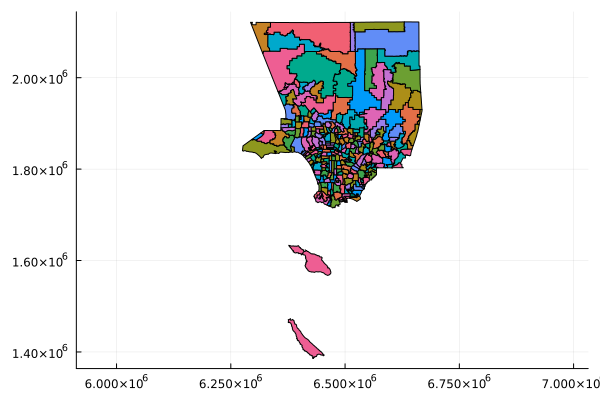

In [22]:
plot(geom, aspectratio=:equal)

In [28]:
table.ZIPCODE

311-element Vector{String}:
 "90001"
 "90002"
 "90003"
 "90004"
 "90005"
 "90006"
 "90007"
 "90008"
 "90010"
 "90011"
 "90012"
 "90013"
 "90014"
 ⋮
 "93534"
 "93535"
 "93536"
 "93543"
 "93544"
 "93550"
 "93551"
 "93552"
 "93553"
 "93563"
 "93591"
 "90704"